<a href="https://colab.research.google.com/github/KatherinReyes06/Topicos_En_Estadistica/blob/main/proyecto_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Planteamiento del problema

Haciendo uso de los datos de iris en Python, llevaremos a cabo la construcción de un modelo de clasificación. Este modelo nos permitirá, a partir de ciertas características como el ancho y longitud del pétalo, así como la longitud del sépalo, determinar a qué categoría pertenece nuestra flor. Asimismo, emplearemos estos mismos datos para desarrollar un modelo de regresión.

# Creación de un bosque aleatorio para clasificación

### Cargamos las librerias necesarias para nuestros modelo

In [12]:
import numpy as np
import pandas as pd
from sklearn.datasets import load_iris
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import mean_squared_error
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

## Explicación de las librerias:


**numpy:** Es una librería de Python especializada en el cálculo numérico y el análisis de datos, especialmente para un gran volumen de datos.

Incorpora una nueva clase de objetos llamados arrays que permite representar colecciones de datos de un mismo tipo en varias dimensiones, y funciones muy eficientes para su manipulación.

**pandas:** Es una librería de Python especializada en el manejo y análisis de estructuras de datos.

Las principales características de esta librería son:


*   Realiza todas estas operaciones de manera muy eficiente.
*   Permite acceder a los datos mediante índices o nombres para filas y columnas.

*   Permite acceder a los datos mediante índices o nombres para filas y columnas.
*   Ofrece métodos para reordenar, dividir y combinar conjuntos de datos.

*   Define nuevas estructuras de datos basadas en los arrays de la librería NumPy pero con nuevas funcionalidades.
*   Permite leer y escribir fácilmente ficheros en formato CSV, Excel y bases de datos SQL.

*   Permite acceder a los datos mediante índices o nombres para filas y columnas.
*   Permite acceder a los datos mediante índices o nombres para filas y columnas.







## Cargar el conjunto de datos

In [13]:
# Cargar el conjunto de datos Iris
iris = load_iris()
X = iris.data
y = iris.target

# Crear un DataFrame para explorar los datos
df = pd.DataFrame(data=np.c_[iris['data'], iris['target']], columns=iris['feature_names'] + ['target'])

# Visualizar las primeras filas del DataFrame
print(df.head())

   sepal length (cm)  sepal width (cm)  petal length (cm)  petal width (cm)  \
0                5.1               3.5                1.4               0.2   
1                4.9               3.0                1.4               0.2   
2                4.7               3.2                1.3               0.2   
3                4.6               3.1                1.5               0.2   
4                5.0               3.6                1.4               0.2   

   target  
0     0.0  
1     0.0  
2     0.0  
3     0.0  
4     0.0  


## Datos de entrenamiento y validación

Seleccionamos el 80% de los datos como conjunto de entrenamiento, reservando el 20% restante para fines de verificación. Es relevante destacar que los datos se eligen sin repetición. Además, nuestro parámetro random_state=42 actúa como semilla para garantizar la reproducibilidad de los resultados.

In [14]:
# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

## Crear y entrenar el modelo

In [15]:
# Crear el modelo de árbol de decisión
forest_classifier = RandomForestClassifier(random_state=42)

# Entrenar el modelo con los datos de entrenamiento
forest_classifier.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

## Realizar predicciones y evaluar el modelo


In [16]:
# Realizar predicciones en el conjunto de prueba
y_pred = forest_classifier.predict(X_test)

# Calcular la precisión del modelo
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy con Random Forest: %.3f" %(accuracy_score(forest_classifier.predict(X_test), y_test)))

Accuracy con Random Forest: 1.000


En nuestro caso, podemos observar que nuestro modelo se ajusta de manera significativa a los datos de entrenamiento y muestra un rendimiento destacado con los datos de validación.

# Matriz de confusión

In [17]:
from sklearn.metrics import confusion_matrix
import pylab as pl
cm = confusion_matrix(y_test, y_pred)

Text(0.5, 1.0, 'Confusion Matrix')

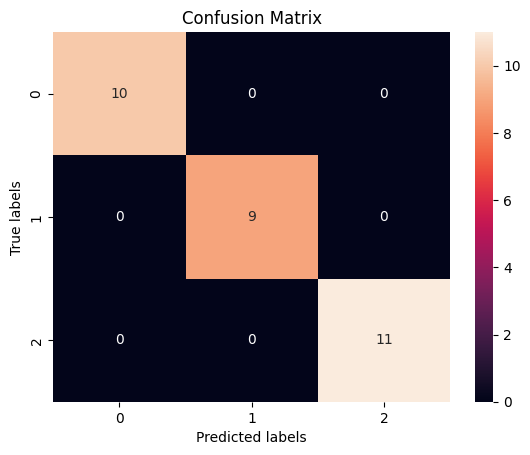

In [18]:
import seaborn as sns
import matplotlib.pyplot as plt

ax= plt.subplot()
sns.heatmap(cm, annot=True, fmt='g', ax=ax);

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.set_title('Confusion Matrix')

## Visualizar el Random Forest

En el siguiente código podemos visualizar todos los arboles que componen nuestro bosque, en nuestro caso tenemos 100 arboles.

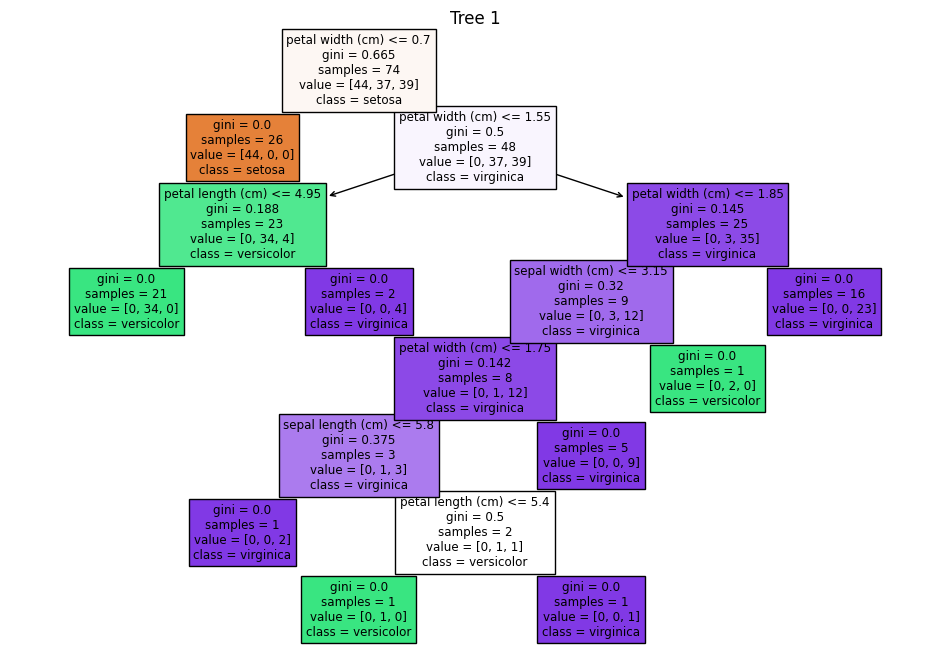

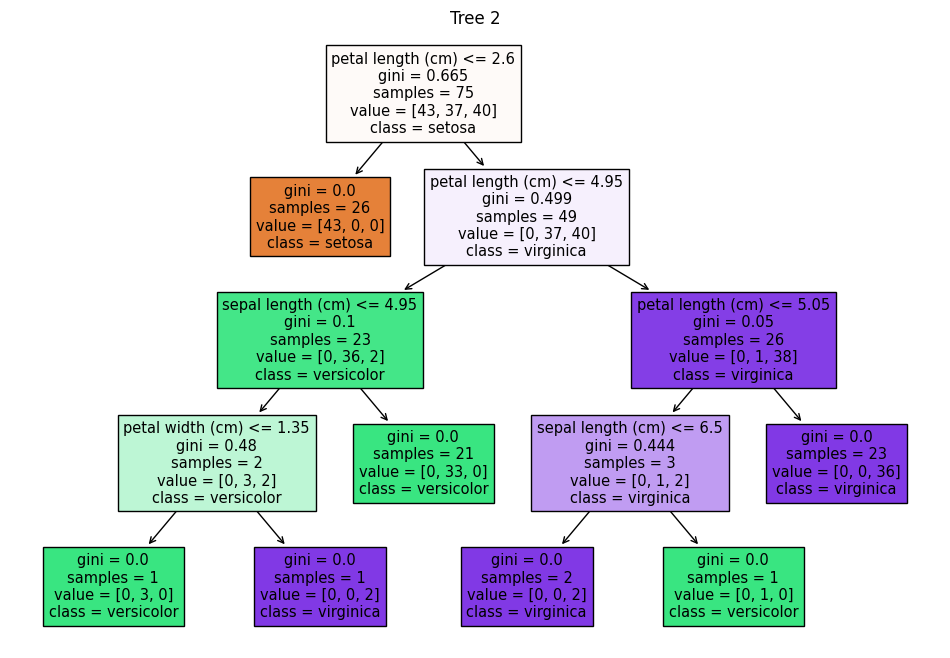

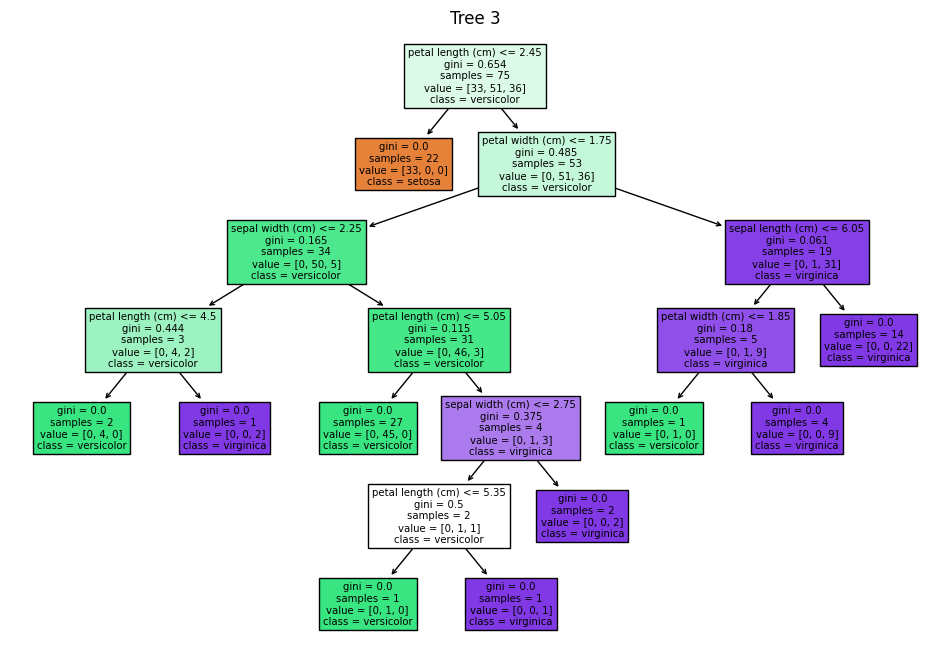

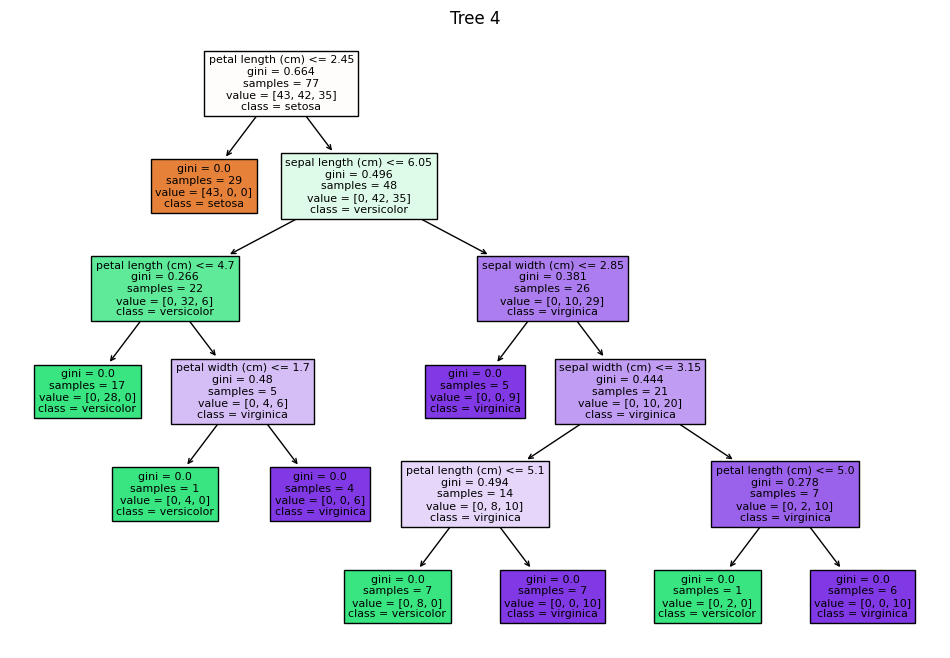

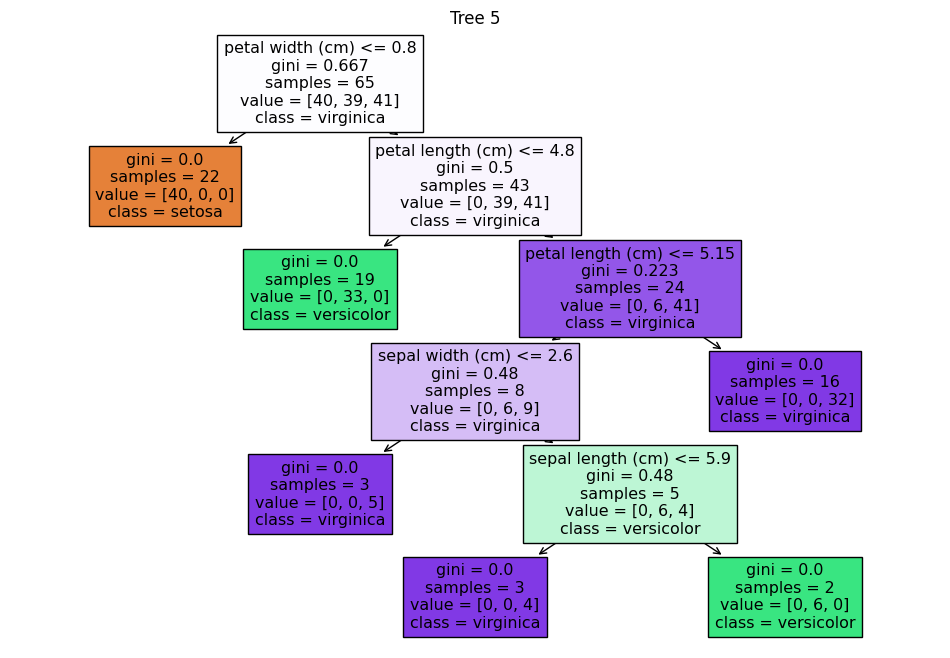

...

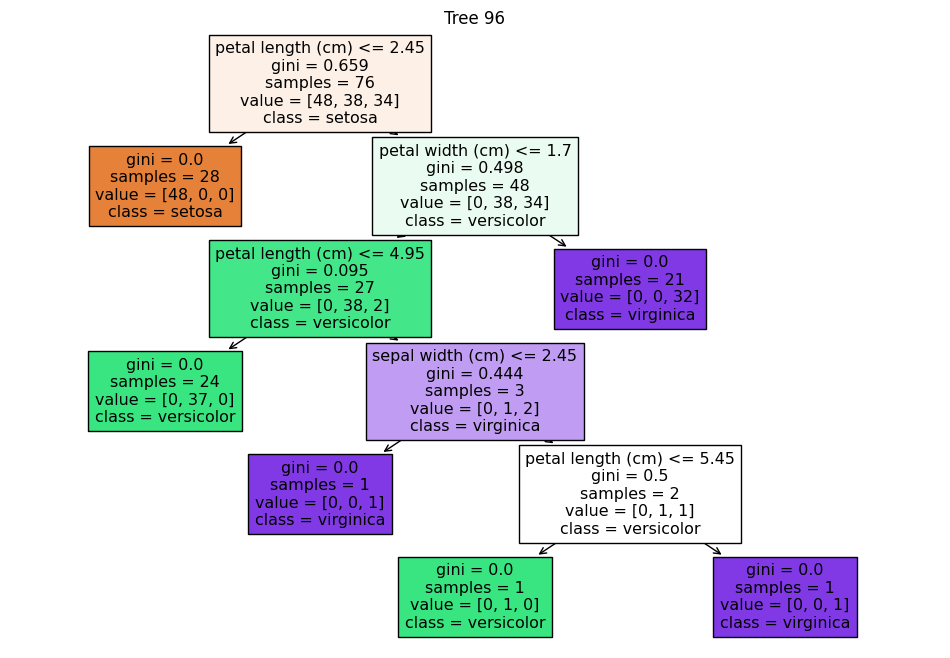

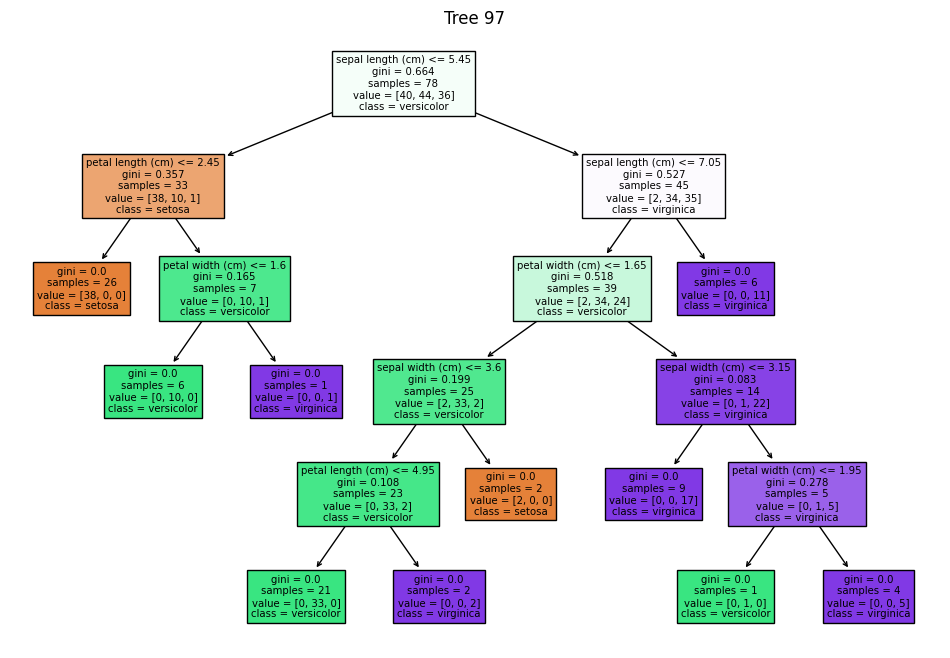

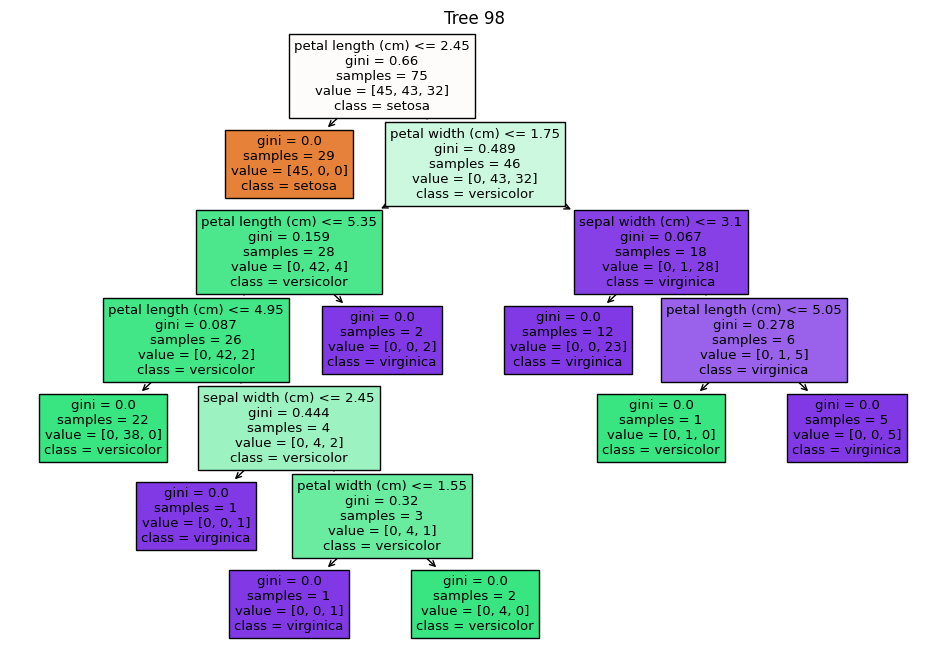

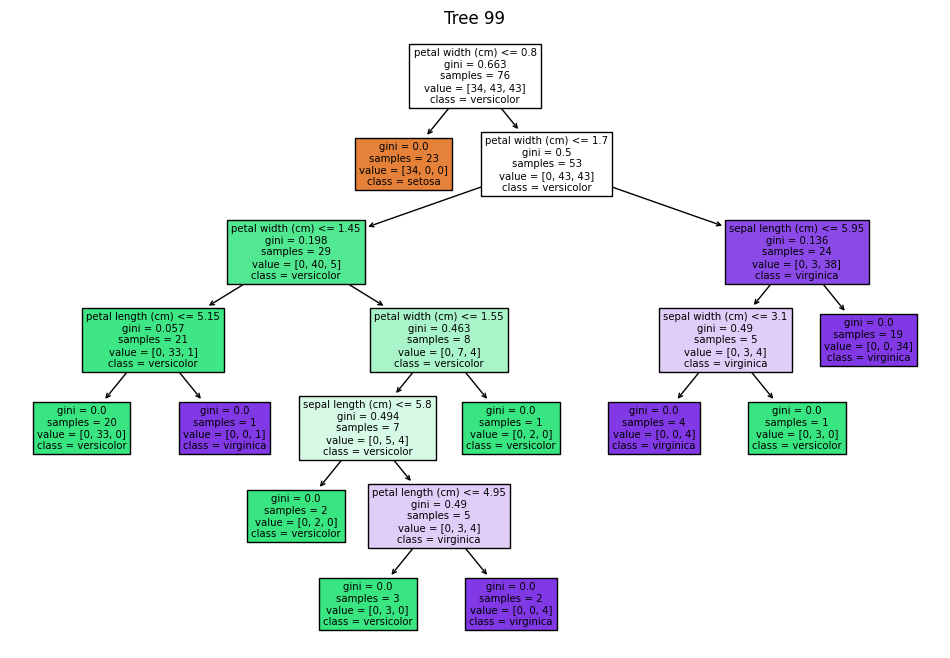

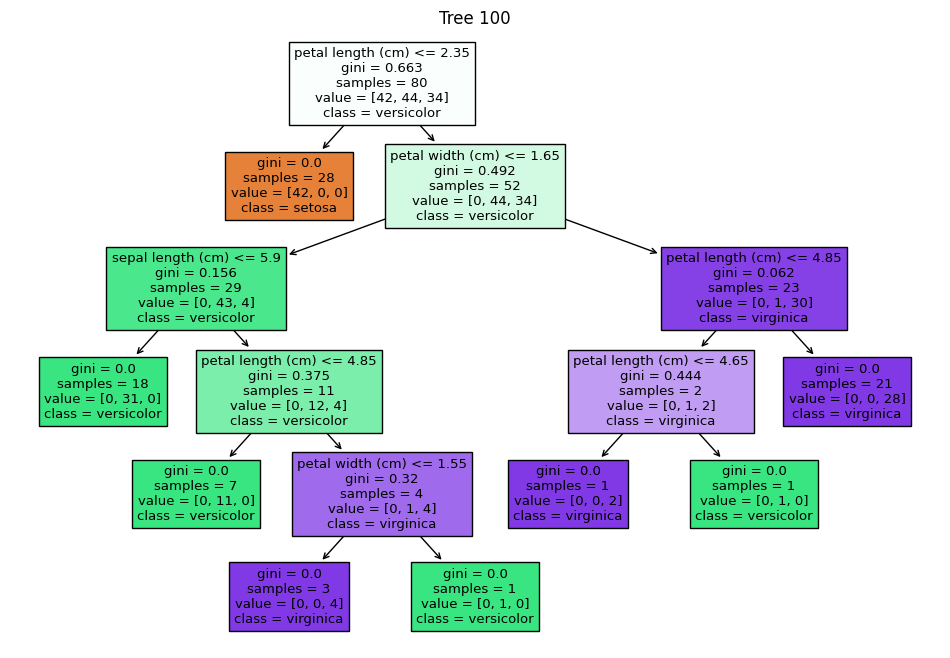

In [ ]:
trees = forest_classifier.estimators_

# Visualizar todos los árboles
for i, tree in enumerate(trees):
    plt.figure(figsize=(12, 8))
    plot_tree(tree, filled=True, feature_names=iris.feature_names, class_names=iris.target_names)
    plt.title(f'Tree {i + 1}')
    plt.show()

Visualización de un arbol en especifico de nuestro bosque, tener en cuenta que nuestro indice empieza en cero.

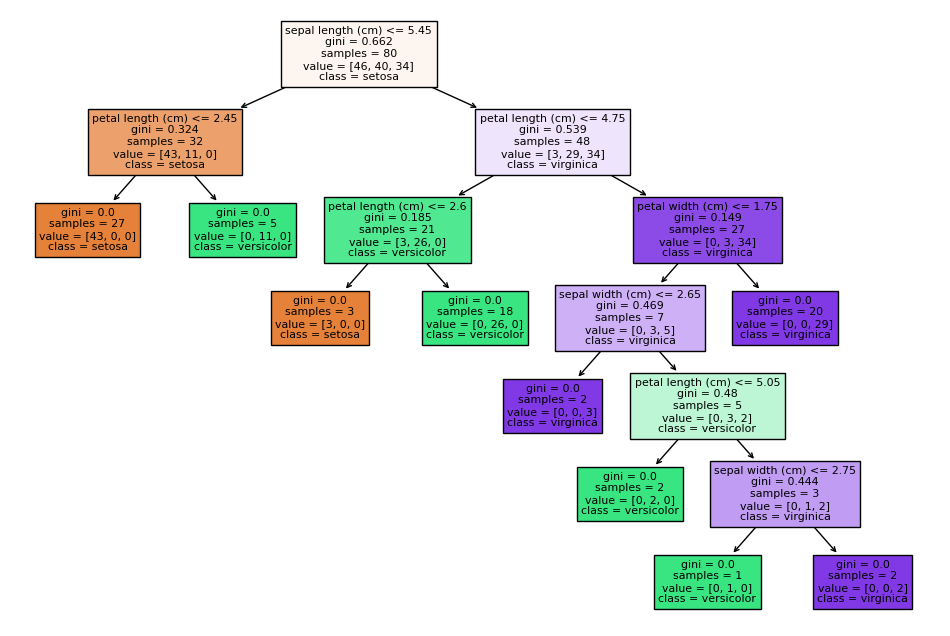

In [ ]:
plt.figure(figsize=(12, 8))
tree = forest_classifier.estimators_[85]
plot_tree(tree, filled=True, feature_names=iris.feature_names, class_names=iris.target_names)
plt.show()

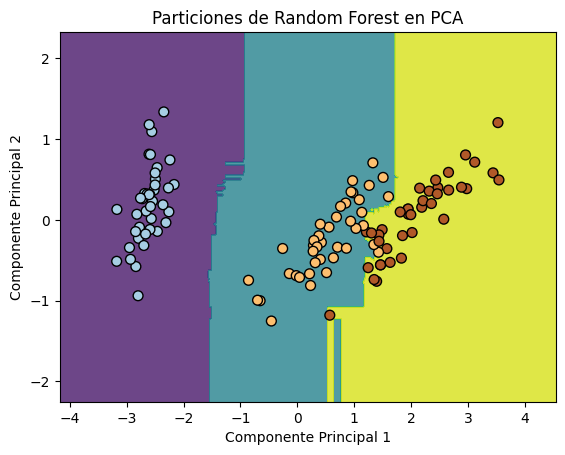

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Aplicar PCA a los datos
pca = PCA(n_components=2)
X_train_pca = pca.fit_transform(X_train)
X_test_pca = pca.transform(X_test)

# Crear el modelo de Random Forest Classifier
forest_classifier_pca = RandomForestClassifier(random_state=42)

# Entrenar el modelo con los datos de entrenamiento reducidos por PCA
forest_classifier_pca.fit(X_train_pca, y_train)

# Crear una malla para la visualización
h = .02
x_min, x_max = X_train_pca[:, 0].min() - 1, X_train_pca[:, 0].max() + 1
y_min, y_max = X_train_pca[:, 1].min() - 1, X_train_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Realizar predicciones en la malla
Z = forest_classifier_pca.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

# Visualizar las particiones y los puntos de datos originales
plt.contourf(xx, yy, Z, alpha=0.8)
plt.scatter(X_train_pca[:, 0], X_train_pca[:, 1], c=y_train, edgecolors='k', marker='o', s=50, linewidth=1, cmap=plt.cm.Paired)
plt.title("Particiones de Random Forest en PCA")
plt.xlabel("Componente Principal 1")
plt.ylabel("Componente Principal 2")
plt.show()


------------------------------------------------------------------------------------------------------

## Creación y entrenamiento del modelo para regresión


In [20]:
# Creación del modelo
forest_regressor = RandomForestRegressor(random_state = 42)

# Entrenamiento del modelo
forest_regressor.fit(X_train, y_train)

RandomForestRegressor(random_state=42)

## Realizar predicciones y evaluar el modelo

In [21]:
# Realizar predicciones en el conjunto de prueba
prediccion = forest_regressor.predict(X_test)

# Calcular el error del modelo
rmse = mean_squared_error(
        y_true  = y_test,
        y_pred  = prediccion,
        squared = False
       )
print(f"El error de test es: {rmse}")

El error de test es: 0.037193189340702336


## Visualizar el random forest para regresión

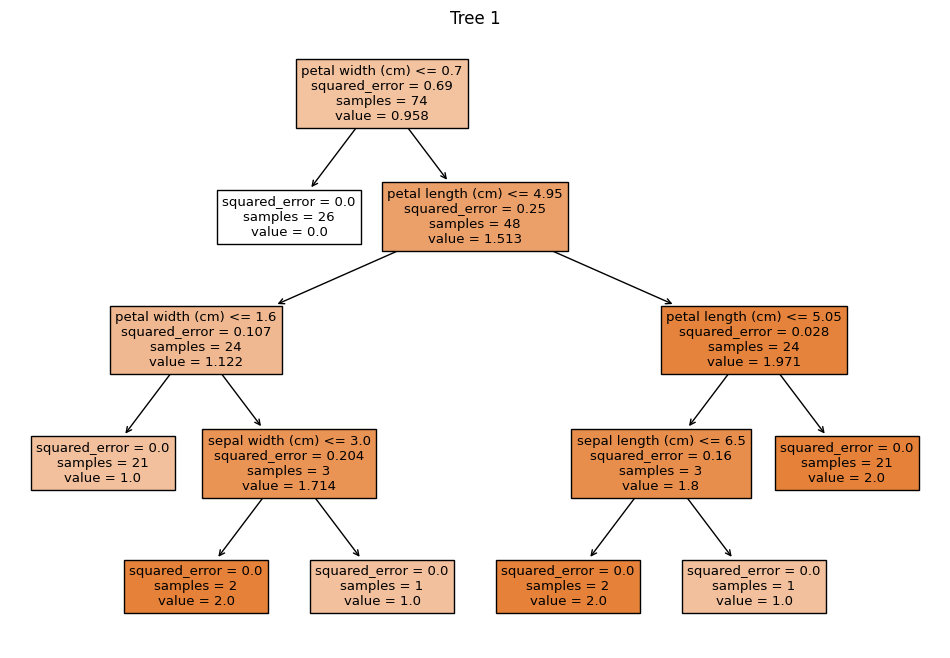

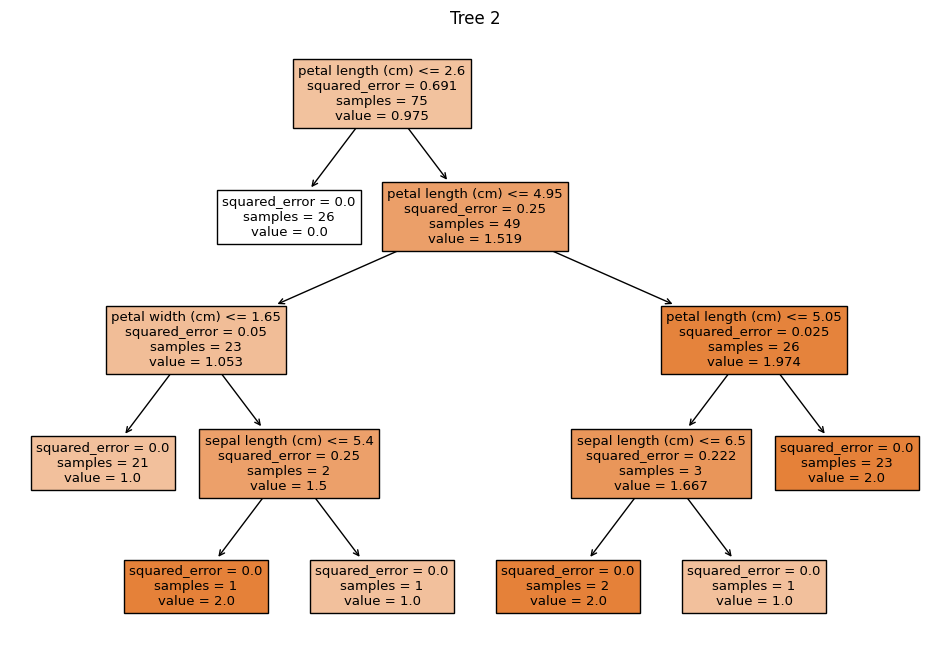

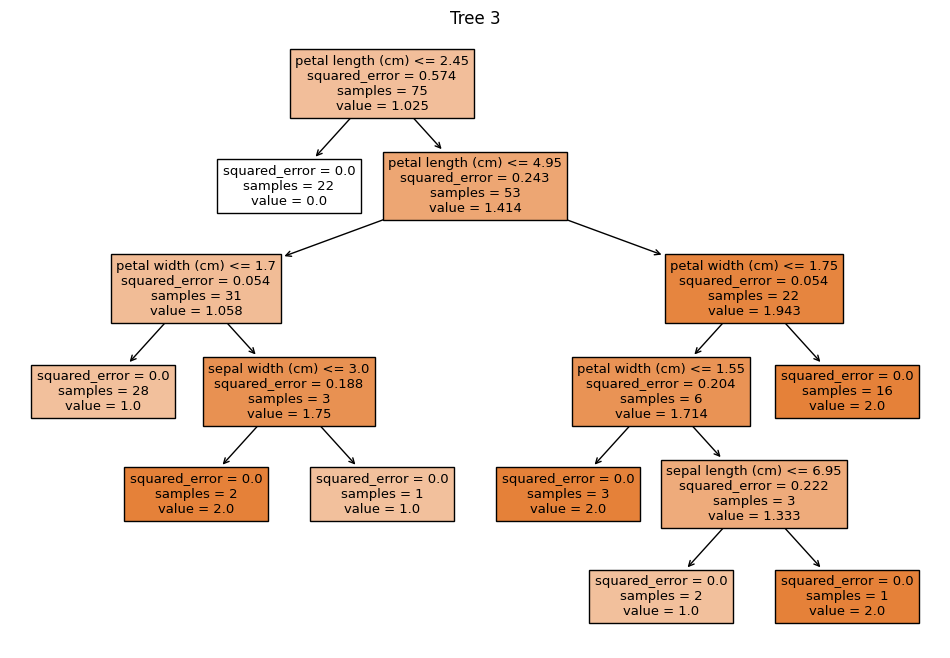

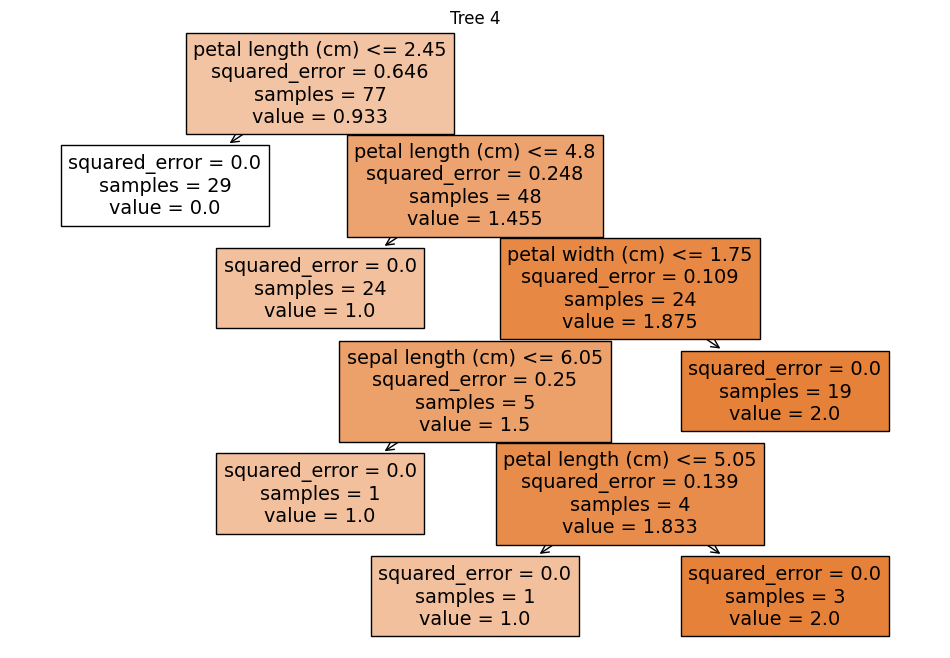

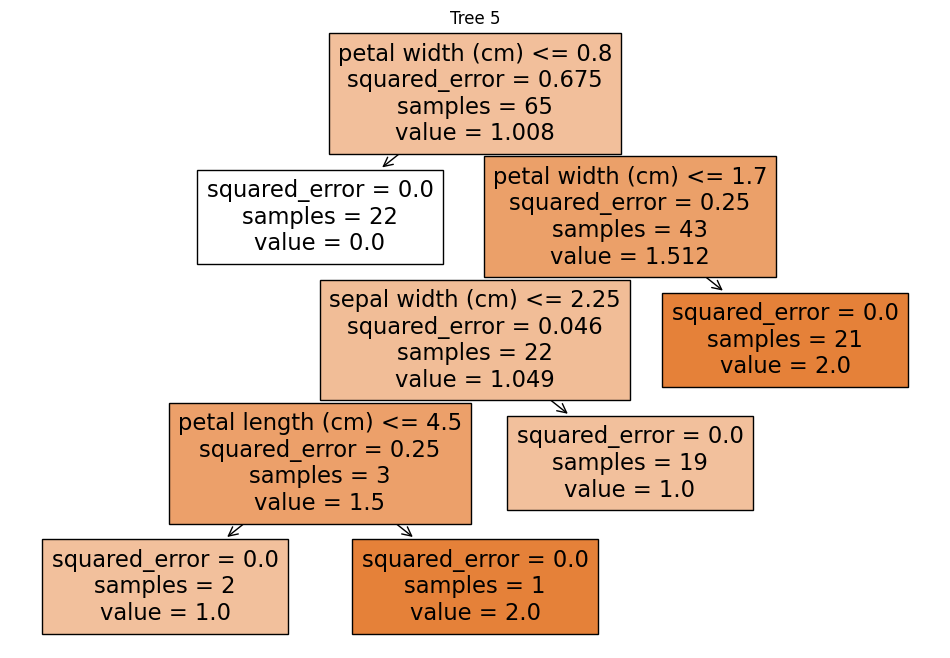

...

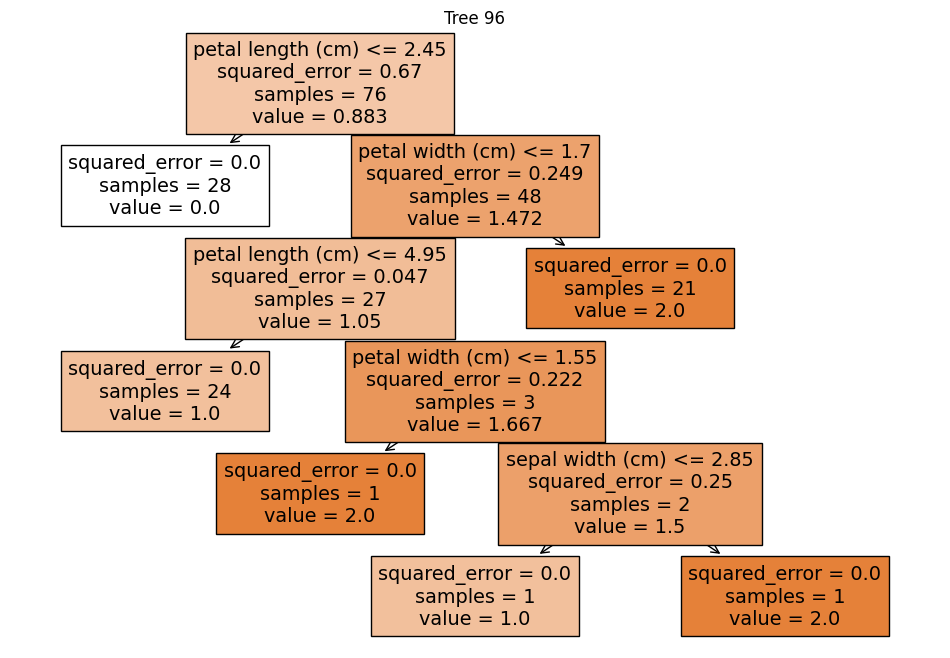

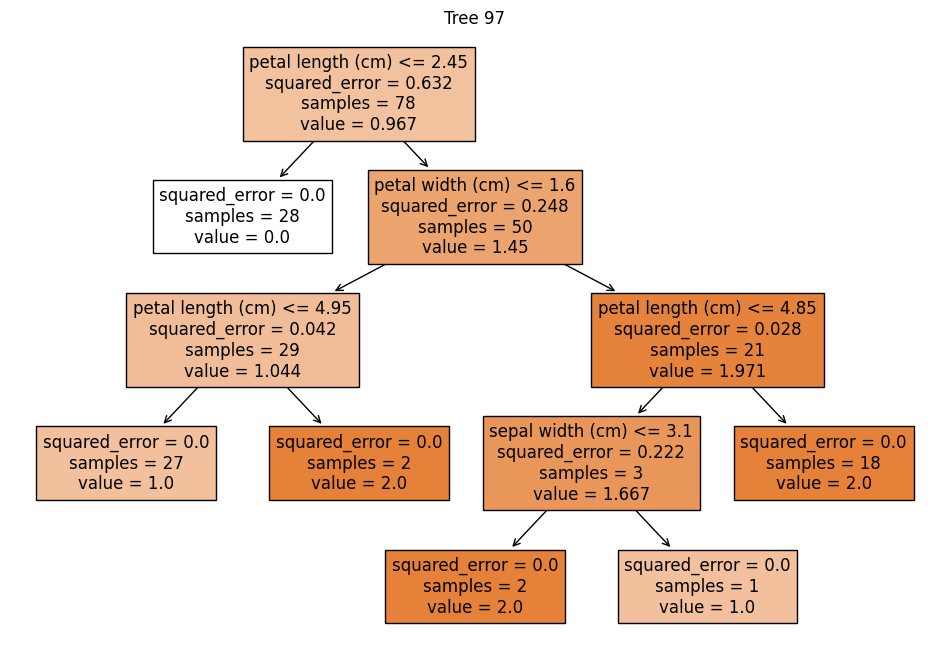

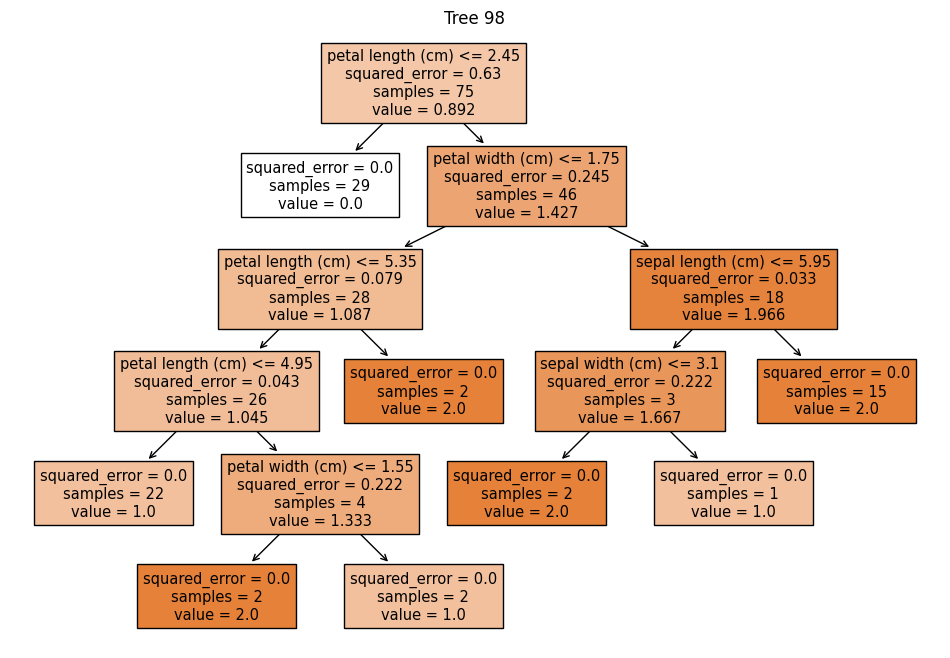

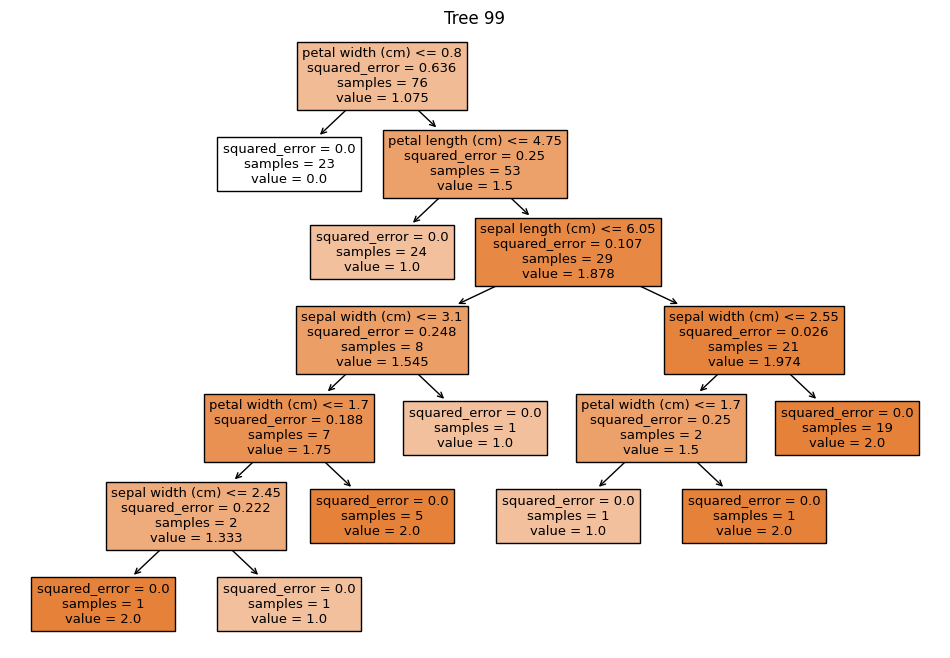

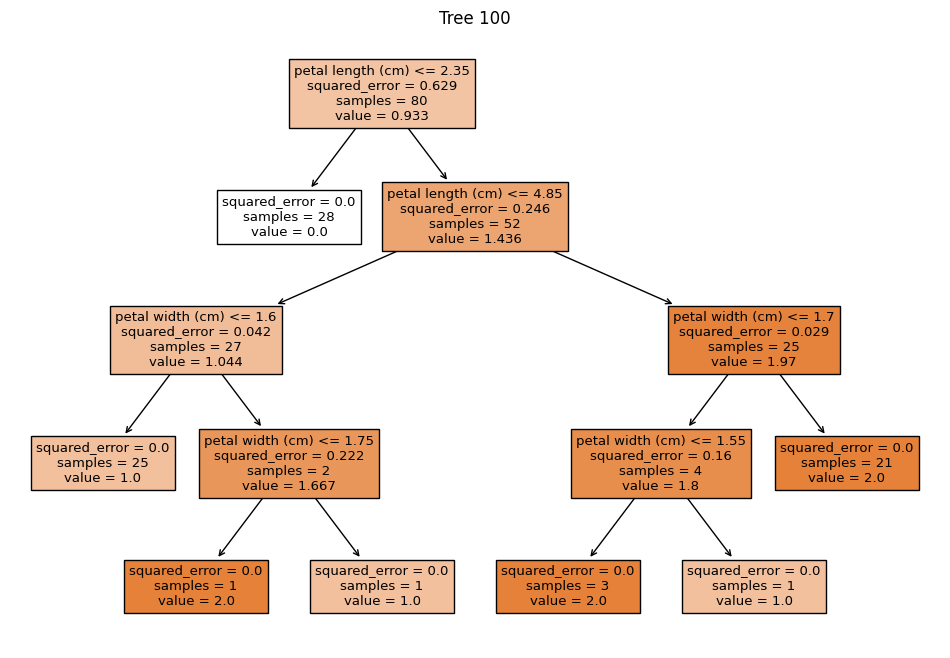

In [ ]:
trees = forest_regressor.estimators_

# Visualizar todos los árboles
for i, tree in enumerate(trees):
    plt.figure(figsize=(12, 8))
    plot_tree(tree, filled=True, feature_names=iris.feature_names, class_names=iris.target_names)
    plt.title(f'Tree {i + 1}')
    plt.show()

Visualización de un árbol en específico de nuestro bosque

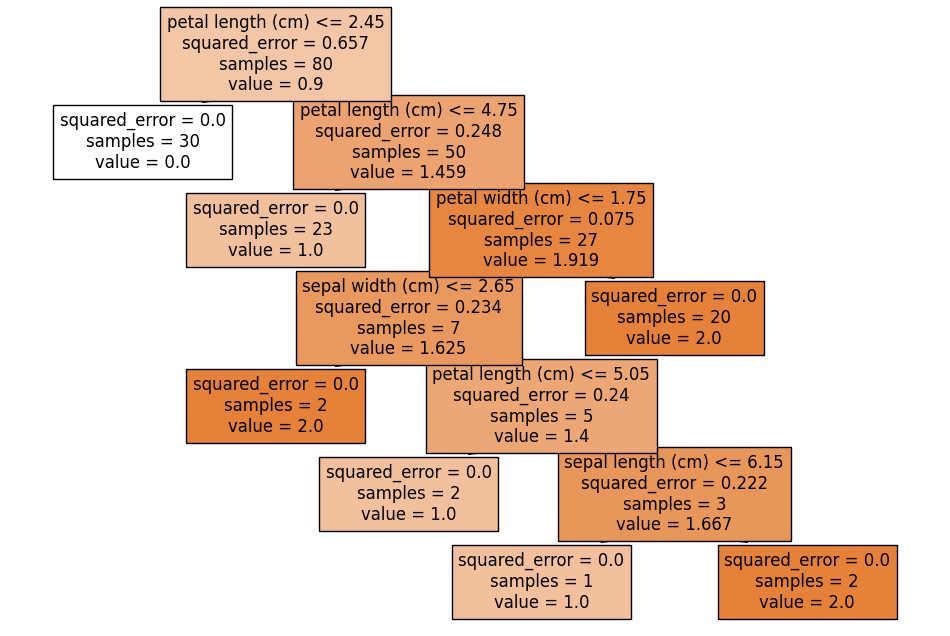

In [ ]:
plt.figure(figsize=(12, 8))
tree = forest_regressor.estimators_[85]
plot_tree(tree, filled=True, feature_names=iris.feature_names, class_names=iris.target_names)
plt.show()

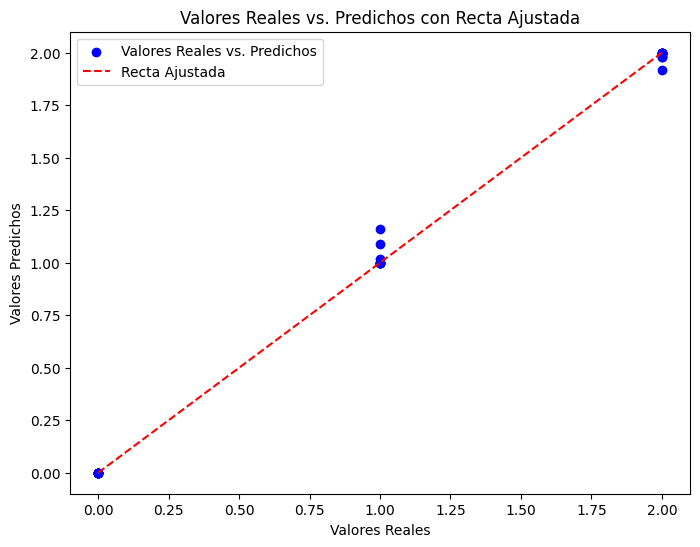

In [ ]:
# Crear una figura
plt.figure(figsize=(8, 6))

# Graficar los valores reales contra los predichos
plt.scatter(y_test, prediccion, color='blue', label='Valores Reales vs. Predichos')

# Graficar la recta ajustada
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle='--', color='red', label='Recta Ajustada')

# Configurar la leyenda y etiquetas de los ejes
plt.legend()
plt.title("Valores Reales vs. Predichos con Recta Ajustada")
plt.xlabel("Valores Reales")
plt.ylabel("Valores Predichos")

# Mostrar la gráfica
plt.show()
